# Geospatial Data Visualization using Python and Folium
In this project, we'll analyze geospatial data from about 100 taxis in Porto, Portugal. We'll prepare this data and use visualization tools, especially the Folium module in Python, to gain insights.


## TASK 1
Importing modules

In [197]:
import pandas as pd 
import datetime , calendar
import folium
import ee
import geemap.foliumap as geemap



Importing our data

In [198]:
Data_Taxis=pd.read_csv('dataset_Taxis_Porto.csv')
Data_Taxis.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH
0,1372636858620000589,C,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499..."
1,1372637303620000596,B,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351..."
2,1372636951620000320,C,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)..."
3,1372636854620000520,C,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705..."
4,1372637091620000337,C,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)..."


### Let's talk about the different columns
---
- CALL_TYPE: The way used to demand taxi service
    - 'A' : if this trip was dispatched from the central
    - 'B' : if this trip was demanded directly to a taxi driver on a specific stand 
    - 'C' : other (i.e. a trip demanded on a random street)

- TIMESTAMP: When the trip starts 

- TRIP_PATH: Contains a list of coordinates
    - The first element is the coordinates of the trip's starting point
    - The last element is the coordinates of the trip's end point

## TASK 2
### Data Preprocessing 
Let's extract starting and ending points of each trip <br>

    - Creating two columns START_LOC and END_LOC

In [199]:
Data_Taxis['START_LOC']=[(eval(Data_Taxis['TRIP_PATH'].iloc[index]))[0] for index, value in enumerate(Data_Taxis['TRIP_PATH'])]
Data_Taxis['END_LOC']=[(eval(Data_Taxis['TRIP_PATH'].iloc[index]))[-1] for index, value in enumerate(Data_Taxis['TRIP_PATH'])]

Data_Taxis.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC
0,1372636858620000589,C,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)"
1,1372637303620000596,B,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)"
2,1372636951620000320,C,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)"
3,1372636854620000520,C,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)"
4,1372637091620000337,C,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)"


Remapping CALL_TYPE column values to the proper values

In [200]:
CALL_TYPES = {
              "A":"CENTRAL_BASED",
              "B":"STAND_BASED",
              "C":"OTHER"
             }

Data_Taxis['CALL_TYPE'].replace(CALL_TYPES, inplace=True)
Data_Taxis.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC
0,1372636858620000589,OTHER,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)"
1,1372637303620000596,STAND_BASED,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)"
2,1372636951620000320,OTHER,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)"
3,1372636854620000520,OTHER,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)"
4,1372637091620000337,OTHER,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)"


### Data Analysis 
Let's answer to some analytical questions using our data 
 
 

### Question 1 - What are the most common ways to get a taxi in Porto?

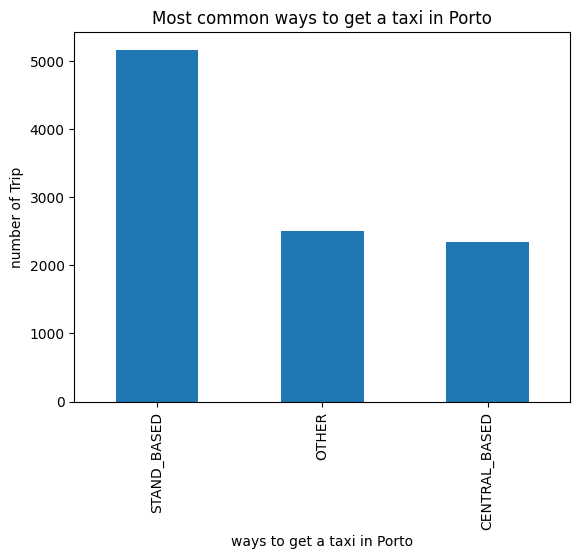

In [201]:
q1_data=Data_Taxis['CALL_TYPE'].value_counts(sort=True)
q1_data.plot.bar(xlabel='ways to get a taxi in Porto',ylabel='number of Trip', title='Most common ways to get a taxi in Porto');


# TASK 3

### Question 2 - Which regions of the city are the best pick up points?
    To answer to this question we can use a dotmap.
    A dotmap is a scatter plot which is put on a map to represent a geographic data distribution.
    And then by looking at the different clusters of the points on the map we can get the answer.

Let's load our map 

In [202]:


Map=folium.Map(location=[41.15,-8.62], zoom_start=14)

for point in  Data_Taxis['START_LOC']:  
    folium.CircleMarker(location=point, color='red', radius=1, weight=2,legend_name='test').add_to(Map)
legend_html = """
<div style="position: fixed; 
            bottom: 10px; left: 10px; width: 160px; height: 60px; 
            border:2px solid grey; z-index:9999; font-size:14px;
            background-color:white;
            ">
<b>Legend</b> <br>
<svg width="10" height="10">
    <circle cx="5" cy="5" r="4" stroke="red" stroke-width="2" fill="red" />
</svg>
&nbsp;Pick up points
</div>
""" 

Map.get_root().html.add_child(folium.Element(legend_html))



Map    


### Question 3 - Which regions of the city are the best pick up points for stand-based trips?
    To answer to this question we create a dotmap with different Marker clusters, each cluster corresponds to a specific
    CALL_TYPE.

Let's check our data again 

In [203]:
Data_Taxis.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC
0,1372636858620000589,OTHER,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)"
1,1372637303620000596,STAND_BASED,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)"
2,1372636951620000320,OTHER,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)"
3,1372636854620000520,OTHER,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)"
4,1372637091620000337,OTHER,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)"


In [204]:
Data_Taxis_OTHER=Data_Taxis[Data_Taxis['CALL_TYPE']=='OTHER']
Data_Taxis_SB=Data_Taxis[Data_Taxis['CALL_TYPE']=='STAND_BASED']
Data_Taxis_CB=Data_Taxis[Data_Taxis['CALL_TYPE']=='CENTRAL_BASED']


Map=folium.Map(location=[41.15,-8.62], zoom_start=14)

for point in  Data_Taxis_OTHER['START_LOC']:  
    folium.CircleMarker(location=point, color='red', radius=1, weight=2).add_to(Map)
for point in  Data_Taxis_SB['START_LOC']:  
    folium.CircleMarker(location=point, color='purple', radius=1, weight=2).add_to(Map)    
for point in  Data_Taxis_CB['START_LOC']:  
    folium.CircleMarker(location=point, color='blue', radius=1, weight=2).add_to(Map)  
    
legend_html = """
<div style="position: fixed; 
            bottom: 10px; left: 10px; width: 160px; height: 100px; 
            border:2px solid grey; z-index:9999; font-size:14px;
            background-color:white;
            ">
<b>Taxi pick up art</b> <br>
<svg width="10" height="10">
    <circle cx="5" cy="5" r="4" stroke="red" stroke-width="2" fill="red" />
</svg>
&nbsp;Other <br>
<svg width="10" height="10">
    <circle cx="5" cy="5" r="4" stroke="purple" stroke-width="2" fill="purple" />
</svg>
&nbsp;Stand Based <br>
<svg width="10" height="10">
    <circle cx="5" cy="5" r="4" stroke="blue" stroke-width="2" fill="blue" />
</svg>
&nbsp;Central Based
</div>
"""

Map.get_root().html.add_child(folium.Element(legend_html))    
    
Map

Let's create our map

In [205]:
Data_Taxis.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC
0,1372636858620000589,OTHER,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)"
1,1372637303620000596,STAND_BASED,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)"
2,1372636951620000320,OTHER,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)"
3,1372636854620000520,OTHER,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)"
4,1372637091620000337,OTHER,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)"


## TASK 4
### Question 4 - Which regions of the city are the most common destinations on Mondays? 
    To answer to this question we need to use the TIMESTAMP column to extract the day each trip took place. 

In [206]:
day_names=list(calendar.day_name)
day_names
Data_Taxis['date']=Data_Taxis['TIMESTAMP']
for index, value in enumerate(Data_Taxis['TIMESTAMP']): 
    Data_Taxis['date'].iloc[index]=datetime.datetime.fromtimestamp(Data_Taxis['TIMESTAMP'][index]).weekday();
    

for index, value in enumerate(Data_Taxis['TIMESTAMP']): 
   
    Data_Taxis['date'].iloc[index]=day_names[Data_Taxis['date'].iloc[index]];


/var/folders/42/q3x51fsx3mj9kg08m4kqcqb40000gn/T/ipykernel_49069/4196403653.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Data_Taxis['date'].iloc[index]=datetime.datetime.fromtimestamp(Data_Taxis['TIMESTAMP'][index]).weekday();
/var/folders/42/q3x51fsx3mj9kg08m4kqcqb40000gn/T/ipykernel_49069/4196403653.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Data_Taxis['date'].iloc[index]=day_names[Data_Taxis['date'].iloc[index]];


Let's get all the trips on Mondays 

In [207]:
q4=Data_Taxis[Data_Taxis['date']=='Monday']

Now Let's visualize the data on the map

In [220]:
Data_Taxis_Monday=Data_Taxis[Data_Taxis['date']=='Monday']
Map1=folium.Map(location=[41.15,-8.62], zoom_start=14)

for point in  Data_Taxis_Monday['END_LOC']:  
    folium.CircleMarker(location=point, color='red', radius=1, weight=2).add_to(Map1)
    
legend_html = """
<div style="position: fixed; 
            bottom: 10px; left: 10px; width: 250px; height: 70px; 
            border:2px solid grey; z-index:9999; font-size:14px;
            background-color:white;
            ">
<b>Legend</b> <br>
<svg width="10" height="10">
    <circle cx="5" cy="5" r="4" stroke="red" stroke-width="2" fill="red" />
</svg>
&nbsp;Most common destinations on Mondays <br>
</div>
"""

Map1.get_root().html.add_child(folium.Element(legend_html))      
    
    
Map1

### Question 5 - What are the most common start and end points on Monday Mornings (from 6 am to 9 am)?
    To answer to this question we need to extract the hour information for each of the trips. 

Let's extract the hour column from TIMESTAMP column 

In [21]:
extract_hour=lambda timestamp:datetime.datetime.fromtimestamp(timestamp).hour
Data_Taxis['Hour']=Data_Taxis['TIMESTAMP'].apply(extract_hour)
Data_Taxis.tail()


,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC,date,Hour
9995,1372840956620000118,OTHER,1372840956,"[(41.159718, -8.577468), (41.160159, -8.576262...","(41.159718, -8.577468)","(41.152698, -8.567109)",Wednesday,10
9996,1372841563620000304,OTHER,1372841563,"[(41.162616, -8.623656)]","(41.162616, -8.623656)","(41.162616, -8.623656)",Wednesday,10
9997,1372836480620000341,OTHER,1372836480,"[(41.150934, -8.598915), (41.150835, -8.598654...","(41.150934, -8.598915)","(41.140134, -8.536419)",Wednesday,9
9998,1372838570620000387,OTHER,1372838570,"[(41.14845, -8.648793), (41.148378, -8.648685)...","(41.14845, -8.648793)","(41.159403, -8.681292)",Wednesday,10
9999,1372837696620000279,CENTRAL_BASED,1372837696,"[(41.149242, -8.664174), (41.149233, -8.664255...","(41.149242, -8.664174)","(41.152959, -8.6742)",Wednesday,9


Let's get the trips which took place between 6 am to 9 am on Mondays

In [30]:
T5_Data=Data_Taxis[(Data_Taxis['date']=='Monday')&(Data_Taxis['Hour']>6)&(Data_Taxis['Hour']<9)]
T5_Data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC,date,Hour
266,1372655154620000386,OTHER,1372655154,"[(41.167341, -8.570286), (41.166702, -8.571087...","(41.167341, -8.570286)","(41.185971, -8.580834)",Monday,7
287,1372655153620000280,OTHER,1372655153,"[(41.163084, -8.663274), (41.162373, -8.66367)...","(41.163084, -8.663274)","(41.163192, -8.676054)",Monday,7
293,1372656656620000280,OTHER,1372656656,"[(41.164119, -8.676972), (41.16483, -8.677854)...","(41.164119, -8.676972)","(41.161032, -8.648604)",Monday,7
295,1372655268620000197,STAND_BASED,1372655268,"[(41.180562, -8.582643), (41.180544, -8.582643...","(41.180562, -8.582643)","(41.144427, -8.60607)",Monday,7
296,1372654879620000329,CENTRAL_BASED,1372654879,"[(41.179446, -8.631387), (41.179419, -8.631531...","(41.179446, -8.631387)","(41.145318, -8.579916)",Monday,7


Now let's visualize this data

In [225]:
Map5=folium.Map(location=[41.15,-8.62], zoom_start=14)
put_start_loc= lambda loc: folium.CircleMarker(location=loc, color='red', radius=1, weight=2).add_to(Map5)
put_end_loc= lambda loc: folium.CircleMarker(location=loc, color='blue', radius=1, weight=2).add_to(Map5)

T5_Data['START_LOC'].apply(put_start_loc)
T5_Data['END_LOC'].apply(put_end_loc)

legend_html = """
<div style="position: fixed; 
            bottom: 10px; left: 10px; width: 380px; height: 80px; 
            border:2px solid grey; z-index:9999; font-size:14px;
            background-color:white;
            ">
<b>Legend</b> <br>
<svg width="10" height="10">
    <circle cx="5" cy="5" r="4" stroke="red" stroke-width="2" fill="red" />
</svg>
&nbsp;Start Position on Monday Mornings (from 6 am to 9 am) <br>
<svg width="10" height="10">
    <circle cx="5" cy="5" r="4" stroke="blue" stroke-width="2" fill="blue" />
</svg>
&nbsp;End Position on Monday Mornings (from 6 am to 9 am) <br>

</div>
"""

Map5.get_root().html.add_child(folium.Element(legend_html))   


Map5

## TASK 5
### Question 6 - Find out the rush hour in Porto

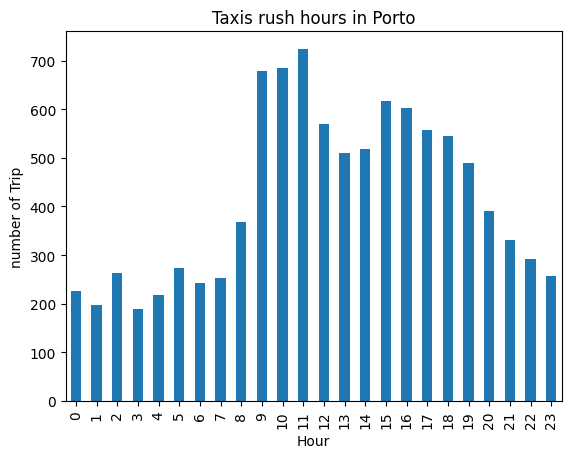

In [57]:

Rush_Hours=Data_Taxis['Hour'].value_counts()
Rush_Hours=Rush_Hours.sort_index()
Rush_Hours.plot.bar(xlabel='Hour',ylabel='number of Trip', title='Taxis rush hours in Porto');


### Question 7 - Which streets has the more traffic during the rush hour
    To answer to this question we need to use TRIP_PATH column to visualize each path as a line on the map.
    Firstly, let's filter out the needed data. 

In [101]:
tree_Top_Rushhour=sorted(Rush_Hours)
tree_Top_Rushhour=tree_Top_Rushhour[-3:]
list(Rush_Hours[Rush_Hours==724].index)
Rush_Hours_List=[]
for x in tree_Top_Rushhour:
    Rush_Hours_List.append(list(Rush_Hours[Rush_Hours==x].index)[0])
    

In [146]:


Data_Taxis_Rush_Hour=Data_Taxis[(Data_Taxis['Hour']==9)|(Data_Taxis['Hour']==10)|(Data_Taxis['Hour']==11)]
Data_Taxis_Rush_Hour.head()
TRIP_PATH_CORD=Data_Taxis_Rush_Hour['TRIP_PATH'].iloc[0]
x=lambda Transf:eval(Transf)
Data_Taxis_Rush_Hour['TRIP_PATH']=Data_Taxis_Rush_Hour['TRIP_PATH'].apply(x);

/var/folders/42/q3x51fsx3mj9kg08m4kqcqb40000gn/T/ipykernel_49069/1485758505.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Data_Taxis_Rush_Hour['TRIP_PATH']=Data_Taxis_Rush_Hour['TRIP_PATH'].apply(x);


In [232]:

TRIP_PATH_CORD=Data_Taxis_Rush_Hour['TRIP_PATH'].iloc[0]
Map7=folium.Map(location=[41.15,-8.62], zoom_start=14)
for TRIP_PATH_CORD in Data_Taxis_Rush_Hour['TRIP_PATH']:
        folium.PolyLine(TRIP_PATH_CORD, color='red', opacity=0.05, weight=1).add_to(Map7)

legend_html = """
<div style="position: fixed; 
            bottom: 10px; left: 10px; width: 250; height: 50px; 
            border:2px solid grey; z-index:9999; font-size:14px;
            background-color:white;
            ">
<b>Legend</b> <br>

&nbsp;thicker red lines indicates the most driven streets during rush hour<br>


</div>
"""
Map7.get_root().html.add_child(folium.Element(legend_html))


Map7
